# NASA *Turbofan* RUL predictor

In this notebook we are going to use NASA's turbofan dataset to predict the remaining useful life of an engine.
The link to the dataset is below

[Nasa_turbofan_data](https://www.kaggle.com/darkside92/turbofan-predictive-maintenance-nasa)

### Importing the libraries
*These are the libraries needed for this project*

In [34]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly
import plotly.graph_objs as go
from   plotly.subplots import make_subplots
from   plotly.offline import init_notebook_mode, iplot, plot
init_notebook_mode(connected = True)

### Reading the data into Train-Test and understanding the data

In [35]:
columns=["id","cycle","op1","op2","op3","sensor1","sensor2","sensor3","sensor4","sensor5","sensor6","sensor7","sensor8",
         "sensor9","sensor10","sensor11","sensor12","sensor13","sensor14","sensor15","sensor16","sensor17","sensor18","sensor19"
         ,"sensor20","sensor21","sensor22","sensor23"]

In [36]:
df_train = pd.read_csv('../datasets/train_FD001.txt', sep = " ", names = columns)
df_test = pd.read_csv('../datasets/test_FD001.txt', sep = " ", names = columns)
df_results = pd.read_csv('../datasets/RUL_FD001.txt', sep = " ", names = ['rul', 'null'],header = None)

In [37]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20631 entries, 0 to 20630
Data columns (total 28 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   id        20631 non-null  int64  
 1   cycle     20631 non-null  int64  
 2   op1       20631 non-null  float64
 3   op2       20631 non-null  float64
 4   op3       20631 non-null  float64
 5   sensor1   20631 non-null  float64
 6   sensor2   20631 non-null  float64
 7   sensor3   20631 non-null  float64
 8   sensor4   20631 non-null  float64
 9   sensor5   20631 non-null  float64
 10  sensor6   20631 non-null  float64
 11  sensor7   20631 non-null  float64
 12  sensor8   20631 non-null  float64
 13  sensor9   20631 non-null  float64
 14  sensor10  20631 non-null  float64
 15  sensor11  20631 non-null  float64
 16  sensor12  20631 non-null  float64
 17  sensor13  20631 non-null  float64
 18  sensor14  20631 non-null  float64
 19  sensor15  20631 non-null  float64
 20  sensor16  20631 non-null  fl

In [38]:
df_train.isna().sum()

id              0
cycle           0
op1             0
op2             0
op3             0
sensor1         0
sensor2         0
sensor3         0
sensor4         0
sensor5         0
sensor6         0
sensor7         0
sensor8         0
sensor9         0
sensor10        0
sensor11        0
sensor12        0
sensor13        0
sensor14        0
sensor15        0
sensor16        0
sensor17        0
sensor18        0
sensor19        0
sensor20        0
sensor21        0
sensor22    20631
sensor23    20631
dtype: int64

### Getting initial insights on how the data is distributed
🔑 *key things to look for*
- Mean
- Standard deviation

In [39]:
df_train.describe()

,id,cycle,op1,op2,op3,sensor1,sensor2,sensor3,sensor4,sensor5,sensor6,sensor7,sensor8,sensor9,sensor10,sensor11,sensor12,sensor13,sensor14,sensor15,sensor16,sensor17,sensor18,sensor19,sensor20,sensor21,sensor22,sensor23
count,20631.000000,20631.000000,20631.000000,20631.000000,20631.0,2.063100e+04,20631.000000,20631.000000,20631.000000,2.063100e+04,20631.000000,20631.000000,20631.000000,20631.000000,2.063100e+04,20631.000000,20631.000000,20631.000000,20631.000000,20631.000000,2.063100e+04,20631.000000,20631.0,20631.0,20631.000000,20631.000000,0.0,0.0
mean,51.506568,108.807862,-0.000009,0.000002,100.0,5.186700e+02,642.680934,1590.523119,1408.933782,1.462000e+01,21.609803,553.367711,2388.096652,9065.242941,1.300000e+00,47.541168,521.413470,2388.096152,8143.752722,8.442146,3.000000e-02,393.210654,2388.0,100.0,38.816271,23.289705,NaN,NaN
std,29.227633,68.880990,0.002187,0.000293,0.0,6.537152e-11,0.500053,6.131150,9.000605,3.394700e-12,0.001389,0.885092,0.070985,22.082880,4.660829e-13,0.267087,0.737553,0.071919,19.076176,0.037505,1.556432e-14,1.548763,0.0,0.0,0.180746,0.108251,NaN,NaN
min,1.000000,1.000000,-0.008700,-0.000600,100.0,5.186700e+02,641.210000,1571.040000,1382.250000,1.462000e+01,21.600000,549.850000,2387.900000,9021.730000,1.300000e+00,46.850000,518.690000,2387.880000,8099.940000,8.324900,3.000000e-02,388.000000,2388.0,100.0,38.140000,22.894200,NaN,NaN
25%,26.000000,52.000000,-0.001500,-0.000200,100.0,5.186700e+02,642.325000,1586.260000,1402.360000,1.462000e+01,21.610000,552.810000,2388.050000,9053.100000,1.300000e+00,47.350000,520.960000,2388.040000,8133.245000,8.414900,3.000000e-02,392.000000,2388.0,100.0,38.700000,23.221800,NaN,NaN
50%,52.000000,104.000000,0.000000,0.000000,100.0,5.186700e+02,642.640000,1590.100000,1408.040000,1.462000e+01,21.610000,553.440000,2388.090000,9060.660000,1.300000e+00,47.510000,521.480000,2388.090000,8140.540000,8.438900,3.000000e-02,393.000000,2388.0,100.0,38.830000,23.297900,NaN,NaN
75%,77.000000,156.000000,0.001500,0.000300,100.0,5.186700e+02,643.000000,1594.380000,1414.555000,1.462000e+01,21.610000,554.010000,2388.140000,9069.420000,1.300000e+00,47.700000,521.950000,2388.140000,8148.310000,8.465600,3.000000e-02,394.000000,2388.0,100.0,38.950000,23.366800,NaN,NaN
max,100.000000,362.000000,0.008700,0.000600,100.0,5.186700e+02,644.530000,1616.910000,1441.490000,1.462000e+01,21.610000,556.060000,2388.560000,9244.590000,1.300000e+00,48.530000,523.380000,2388.560000,8293.720000,8.584800,3.000000e-02,400.000000,2388.0,100.0,39.430000,23.618400,NaN,NaN


### Plotting the correlation between the independant variables

*we can drop variables which are highly correlated between each other inorder to reduce complexity and for better model performance*

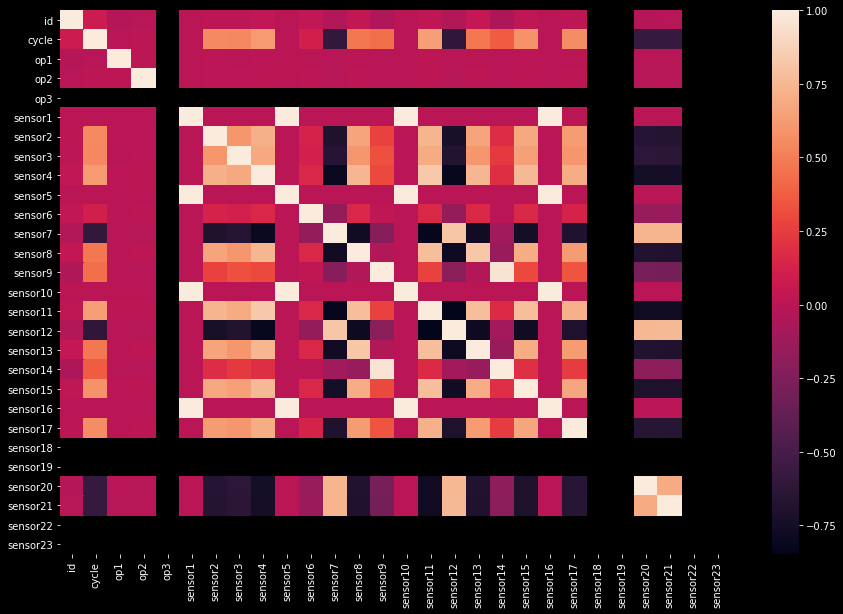

In [40]:
plt.figure(figsize=(15,10))
sns.heatmap(df_train.corr())

In [41]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13096 entries, 0 to 13095
Data columns (total 28 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   id        13096 non-null  int64  
 1   cycle     13096 non-null  int64  
 2   op1       13096 non-null  float64
 3   op2       13096 non-null  float64
 4   op3       13096 non-null  float64
 5   sensor1   13096 non-null  float64
 6   sensor2   13096 non-null  float64
 7   sensor3   13096 non-null  float64
 8   sensor4   13096 non-null  float64
 9   sensor5   13096 non-null  float64
 10  sensor6   13096 non-null  float64
 11  sensor7   13096 non-null  float64
 12  sensor8   13096 non-null  float64
 13  sensor9   13096 non-null  float64
 14  sensor10  13096 non-null  float64
 15  sensor11  13096 non-null  float64
 16  sensor12  13096 non-null  float64
 17  sensor13  13096 non-null  float64
 18  sensor14  13096 non-null  float64
 19  sensor15  13096 non-null  float64
 20  sensor16  13096 non-null  fl

In [42]:
df_results.head(4)

,rul,null
0,112,NaN
1,98,NaN
2,69,NaN
3,82,NaN


In [43]:
df_train.head()

,id,cycle,op1,op2,op3,sensor1,sensor2,sensor3,sensor4,sensor5,sensor6,sensor7,sensor8,sensor9,sensor10,sensor11,sensor12,sensor13,sensor14,sensor15,sensor16,sensor17,sensor18,sensor19,sensor20,sensor21,sensor22,sensor23
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,21.61,554.36,2388.06,9046.19,1.3,47.47,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190,NaN,NaN
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,21.61,553.75,2388.04,9044.07,1.3,47.49,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236,NaN,NaN
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,21.61,554.26,2388.08,9052.94,1.3,47.27,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442,NaN,NaN
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,21.61,554.45,2388.11,9049.48,1.3,47.13,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739,NaN,NaN
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,21.61,554.00,2388.06,9055.15,1.3,47.28,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044,NaN,NaN


In [44]:
print('unique ID: ', df_train.id.unique())

unique ID:  [  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100]


### A quick inference reveals that there are 100 turbofans in this data

## Plotting the *Engine cycle Lifetime*

In [45]:
pd.set_option('max_rows', 1000000)
pd.set_option('max_columns', 1000000)

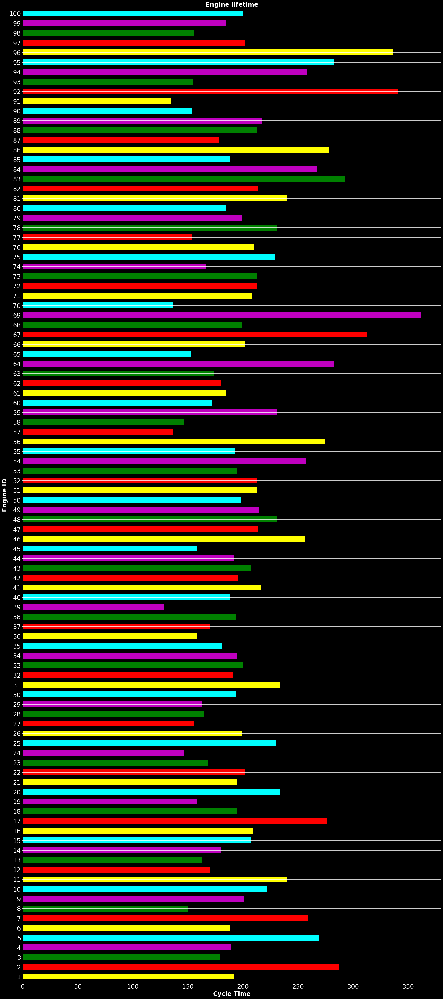

In [46]:
plt.style.use('dark_background')
plt.figure(figsize=(24,54))
df_train.groupby('id').cycle.max().plot(kind = 'barh', width = 0.6, stacked = True, align = 'center', color=['yellow', 'red', 'green', 'm', 'cyan'])
plt.title('Engine lifetime', fontweight = 'bold', size = 24)
plt.xlabel('Cycle Time', fontweight = 'bold', size = 24)
plt.xticks(size = 24)
plt.ylabel('Engine ID', fontweight = 'bold', size = 24)
plt.yticks(size = 24)
plt.grid(True)
plt.tight_layout(True)
plt.show()

# Preprocessing  & Feature Engineering

In [47]:
df_results.drop(['null'], axis = 1, inplace = True)
df_results['id'] = df_results.index + 1
df_results.head(3)

,rul,id
0,112,1
1,98,2
2,69,3


In [48]:
rul = pd.DataFrame(df_test.groupby('id').cycle.max()).reset_index()
rul.columns = ['id', 'max']

In [49]:
rul.head()

,id,max
0,1,31
1,2,49
2,3,126
3,4,106
4,5,98


In [50]:
df_results['rul_failed'] =df_results['rul'] + rul['max']
df_results.head()

,rul,id,rul_failed
0,112,1,143
1,98,2,147
2,69,3,195
3,82,4,188
4,91,5,189


In [51]:
df_results.drop(['rul'], axis = 1, inplace = True)

In [52]:
df_results.shape

(100, 2)

In [53]:
df_test = df_test.merge(df_results, on = ['id'], how = 'left')

In [54]:
df_test.head(5)

,id,cycle,op1,op2,op3,sensor1,sensor2,sensor3,sensor4,sensor5,sensor6,sensor7,sensor8,sensor9,sensor10,sensor11,sensor12,sensor13,sensor14,sensor15,sensor16,sensor17,sensor18,sensor19,sensor20,sensor21,sensor22,sensor23,rul_failed
0,1,1,0.0023,0.0003,100.0,518.67,643.02,1585.29,1398.21,14.62,21.61,553.90,2388.04,9050.17,1.3,47.20,521.72,2388.03,8125.55,8.4052,0.03,392,2388,100.0,38.86,23.3735,NaN,NaN,143
1,1,2,-0.0027,-0.0003,100.0,518.67,641.71,1588.45,1395.42,14.62,21.61,554.85,2388.01,9054.42,1.3,47.50,522.16,2388.06,8139.62,8.3803,0.03,393,2388,100.0,39.02,23.3916,NaN,NaN,143
2,1,3,0.0003,0.0001,100.0,518.67,642.46,1586.94,1401.34,14.62,21.61,554.11,2388.05,9056.96,1.3,47.50,521.97,2388.03,8130.10,8.4441,0.03,393,2388,100.0,39.08,23.4166,NaN,NaN,143
3,1,4,0.0042,0.0000,100.0,518.67,642.44,1584.12,1406.42,14.62,21.61,554.07,2388.03,9045.29,1.3,47.28,521.38,2388.05,8132.90,8.3917,0.03,391,2388,100.0,39.00,23.3737,NaN,NaN,143
4,1,5,0.0014,0.0000,100.0,518.67,642.51,1587.19,1401.92,14.62,21.61,554.16,2388.01,9044.55,1.3,47.31,522.15,2388.03,8129.54,8.4031,0.03,390,2388,100.0,38.99,23.4130,NaN,NaN,143


In [55]:
df_test['remaining_cycle'] = df_test.rul_failed - df_test.cycle
df_test.head(2)

,id,cycle,op1,op2,op3,sensor1,sensor2,sensor3,sensor4,sensor5,sensor6,sensor7,sensor8,sensor9,sensor10,sensor11,sensor12,sensor13,sensor14,sensor15,sensor16,sensor17,sensor18,sensor19,sensor20,sensor21,sensor22,sensor23,rul_failed,remaining_cycle
0,1,1,0.0023,0.0003,100.0,518.67,643.02,1585.29,1398.21,14.62,21.61,553.90,2388.04,9050.17,1.3,47.2,521.72,2388.03,8125.55,8.4052,0.03,392,2388,100.0,38.86,23.3735,NaN,NaN,143,142
1,1,2,-0.0027,-0.0003,100.0,518.67,641.71,1588.45,1395.42,14.62,21.61,554.85,2388.01,9054.42,1.3,47.5,522.16,2388.06,8139.62,8.3803,0.03,393,2388,100.0,39.02,23.3916,NaN,NaN,143,141


In [56]:
df_train.drop(['sensor22','sensor23'], axis = 1, inplace = True)
df_test.drop(['sensor22','sensor23'], axis = 1, inplace = True)

In [57]:
df_test.drop(['rul_failed'], axis = 1, inplace = True)

In [58]:
df_train.isna().sum()

id          0
cycle       0
op1         0
op2         0
op3         0
sensor1     0
sensor2     0
sensor3     0
sensor4     0
sensor5     0
sensor6     0
sensor7     0
sensor8     0
sensor9     0
sensor10    0
sensor11    0
sensor12    0
sensor13    0
sensor14    0
sensor15    0
sensor16    0
sensor17    0
sensor18    0
sensor19    0
sensor20    0
sensor21    0
dtype: int64

In [59]:
df_test.isna().sum()

id                 0
cycle              0
op1                0
op2                0
op3                0
sensor1            0
sensor2            0
sensor3            0
sensor4            0
sensor5            0
sensor6            0
sensor7            0
sensor8            0
sensor9            0
sensor10           0
sensor11           0
sensor12           0
sensor13           0
sensor14           0
sensor15           0
sensor16           0
sensor17           0
sensor18           0
sensor19           0
sensor20           0
sensor21           0
remaining_cycle    0
dtype: int64

In [60]:
df_train['remaining_cycle'] = df_train.groupby('id').cycle.transform(max) - df_train.cycle

In [61]:
df_train.head()

,id,cycle,op1,op2,op3,sensor1,sensor2,sensor3,sensor4,sensor5,sensor6,sensor7,sensor8,sensor9,sensor10,sensor11,sensor12,sensor13,sensor14,sensor15,sensor16,sensor17,sensor18,sensor19,sensor20,sensor21,remaining_cycle
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,21.61,554.36,2388.06,9046.19,1.3,47.47,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190,191
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,21.61,553.75,2388.04,9044.07,1.3,47.49,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236,190
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,21.61,554.26,2388.08,9052.94,1.3,47.27,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442,189
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,21.61,554.45,2388.11,9049.48,1.3,47.13,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739,188
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,21.61,554.00,2388.06,9055.15,1.3,47.28,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044,187


## Visualizing  the operational sensors behaviour

In [62]:
rows = len(df_train.columns.difference(['id', 'cycle', 'remaining_cycle']))
rows

fig = make_subplots(
      
    rows = rows,
    cols = 1,
    shared_xaxes = True,
    vertical_spacing = 0.02,
    subplot_titles = df_train.columns.difference(['id', 'cycle', 'remaining_cycle']),

)

row = 1

for s in df_train.columns.difference(['id', 'cycle', 'remaining_cycle']):
    
    for engine, engine_no in df_train.groupby('id'):
        
        fig.add_trace(go.Scatter(x = engine_no['cycle'], 
                               y = engine_no[s], 
                               mode = 'lines', 
                               name = engine), row = row, col = 1)
        
    row = row + 1

fig.update_layout(
    height = 2400,
    showlegend = True
)

fig.show()

### It seems that there exist variables which is not needed for the model
**EX** : 

- op3
- sensor1 
- sensor5 

etc..

## Visualizing the "*sensor recordings*" of one single engine

In [63]:
rows = len(df_train.columns.difference(['id', 'cycle', 'remaining_cycle']))
rows

fig = make_subplots(
      
    rows = rows,
    cols = 1,
    shared_xaxes = True,
    vertical_spacing = 0.02,
    subplot_titles = df_train.columns.difference(['id', 'cycle', 'remaining_cycle']),

)

row = 1
engine_Id = 24

for s in df_train.columns.difference(['id', 'cycle', 'remaining_cycle']):
    
    fig.add_trace(go.Scatter(x = df_train[df_train.id == engine_Id].cycle, 
                               y = df_train[df_train.id == engine_Id][s], 
                               mode = 'lines', 
                               name = s), row = row, col = 1)
        
    row = row + 1

fig.update_layout(
    height = 2400,
    showlegend = True,
    title_text ='sensor recordings of engine id: 24'
)

fig.show()

## Builiding a Classification model with a Threshold of 30 remaining cycles

In [64]:
cycle = 30
df_train['label'] = df_train.remaining_cycle.apply(lambda x : 1 if x <= cycle else 0 )
df_test['label'] = df_test.remaining_cycle.apply(lambda x : 1 if x <= cycle else 0)

In [65]:
op_set = ['op'+str(i) for i in range(1,4)]
sensor = ['sensor' + str(i) for i in range(1,22)]

In [66]:
df_train.columns

Index(['id', 'cycle', 'op1', 'op2', 'op3', 'sensor1', 'sensor2', 'sensor3',
       'sensor4', 'sensor5', 'sensor6', 'sensor7', 'sensor8', 'sensor9',
       'sensor10', 'sensor11', 'sensor12', 'sensor13', 'sensor14', 'sensor15',
       'sensor16', 'sensor17', 'sensor18', 'sensor19', 'sensor20', 'sensor21',
       'remaining_cycle', 'label'],
      dtype='object')

## intense visualization to eliminate unnecessary variables

*Rechecking...*

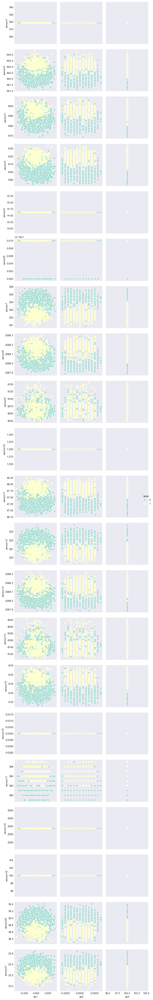

In [69]:
plt.style.use('seaborn-dark')

ax = sns.pairplot(df_test, x_vars = op_set , y_vars = sensor, hue = 'label')
plt.tight_layout(True)
plt.show()

### *Its safe to drop these variables*

- "op3"
- "sensor1"
- "sensor5",
- "sensor6"
- "sensor10"
- "sensor16"
- "sensor18"
- "sensor19"

In [70]:
df_test_binary = df_test.drop(["id","cycle","op3","sensor1","sensor5","sensor6","sensor10","sensor16","sensor18","sensor19"],axis=1)

In [71]:
df_test_binary.head(5)

,op1,op2,sensor2,sensor3,sensor4,sensor7,sensor8,sensor9,sensor11,sensor12,sensor13,sensor14,sensor15,sensor17,sensor20,sensor21,remaining_cycle,label
0,0.0023,0.0003,643.02,1585.29,1398.21,553.90,2388.04,9050.17,47.20,521.72,2388.03,8125.55,8.4052,392,38.86,23.3735,142,0
1,-0.0027,-0.0003,641.71,1588.45,1395.42,554.85,2388.01,9054.42,47.50,522.16,2388.06,8139.62,8.3803,393,39.02,23.3916,141,0
2,0.0003,0.0001,642.46,1586.94,1401.34,554.11,2388.05,9056.96,47.50,521.97,2388.03,8130.10,8.4441,393,39.08,23.4166,140,0
3,0.0042,0.0000,642.44,1584.12,1406.42,554.07,2388.03,9045.29,47.28,521.38,2388.05,8132.90,8.3917,391,39.00,23.3737,139,0
4,0.0014,0.0000,642.51,1587.19,1401.92,554.16,2388.01,9044.55,47.31,522.15,2388.03,8129.54,8.4031,390,38.99,23.4130,138,0


In [72]:
df_train.columns

Index(['id', 'cycle', 'op1', 'op2', 'op3', 'sensor1', 'sensor2', 'sensor3',
       'sensor4', 'sensor5', 'sensor6', 'sensor7', 'sensor8', 'sensor9',
       'sensor10', 'sensor11', 'sensor12', 'sensor13', 'sensor14', 'sensor15',
       'sensor16', 'sensor17', 'sensor18', 'sensor19', 'sensor20', 'sensor21',
       'remaining_cycle', 'label'],
      dtype='object')

In [74]:
X = df_train.drop(["id","cycle","op3","sensor1","sensor5","sensor6","sensor10","sensor16","sensor18","sensor19","remaining_cycle","label"],axis=1)

In [75]:
y = df_train.label

In [76]:
print('x shape : ',X.shape)
print('y shape : ',y.shape)

x shape :  (20631, 16)
y shape :  (20631,)


# Model Building

#### using ***train_test_split*** from sklearn to split the data into training and validation datasets

In [77]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train , y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)

print('X_train shape : ',X_train.shape)
print('X_test shape : ',X_test.shape)
print('y_train shape : ',y_train.shape)
print('y_test shape : ',y_test.shape)

X_train shape :  (16504, 16)
X_test shape :  (4127, 16)
y_train shape :  (16504,)
y_test shape :  (4127,)


## import Lightgbm's Classifier and Train the model

🔑 *important to check the precision, recall and f1score*

In [78]:
import lightgbm as lgb
from sklearn.metrics import confusion_matrix,accuracy_score,r2_score,roc_auc_score,precision_score,recall_score,f1_score

lgb_clsfr = lgb.LGBMClassifier(learning_rate= 0.01, n_estimators= 5000, num_leaves = 100, objective='binary', metrics = 'auc', random_state = 42)
lgb_clsfr.fit(X_train, y_train)
print(lgb_clsfr.score(X_test, y_test))
preds = lgb_clsfr.predict(X_test)
print('Acc score : ', accuracy_score(y_test, preds))
print('Roc Auc score: ', roc_auc_score(y_test, preds))
print('Precision Score : ', precision_score(y_test, preds))
print('Recall score : ', recall_score(y_test, preds))
print('f1 score', f1_score(y_test, preds, 'binary'))

0.9641385994669252
Acc score :  0.9641385994669252
Roc Auc score:  0.9111848464462049
Precision Score :  0.9022140221402214
Recall score :  0.8373287671232876
f1 score 0.8685612788632326


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:68: FutureWarning:

Pass labels=binary as keyword args. From version 0.25 passing these as positional arguments will result in an error



### 💡 Our classifier got an accuracy of **96%** and f1score of **86%**

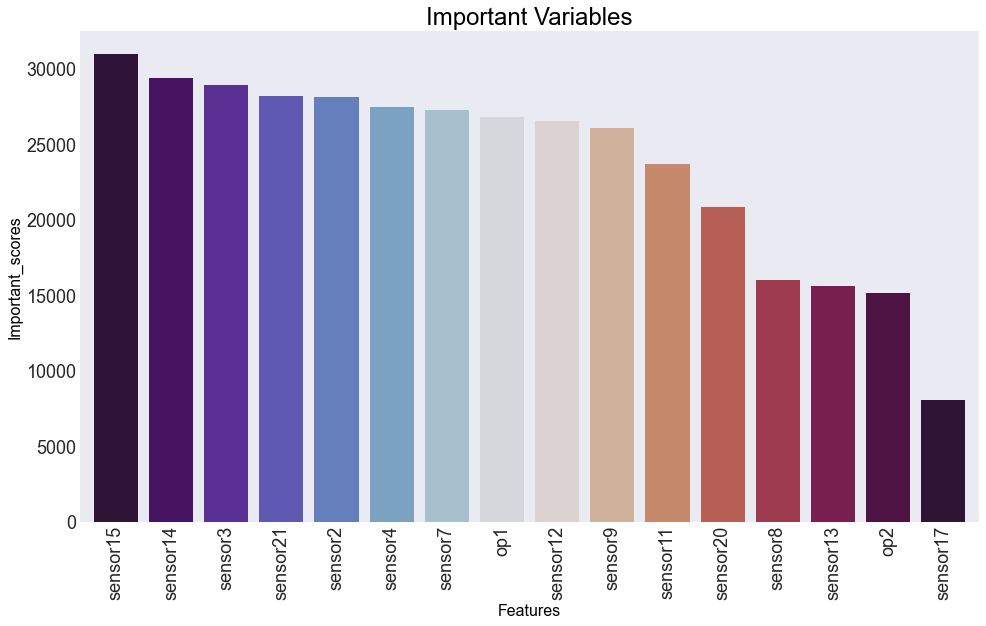

In [79]:
colors = [plt.cm.twilight_shifted(i/float(len(X.columns)-1)) for i in range(len(X.columns))]

columns_X_train = X.columns.to_list()
X_train.set_axis(columns_X_train, axis = 1, inplace = True)
feat_imp = pd.Series(lgb_clsfr.feature_importances_, index = X_train.columns)
plt.figure(figsize=(14,9))
plt.rcParams.update({'font.size' : 18})
plt.title('Important Variables',color='black',fontweight='medium',size=24)
feat_imp.nlargest(16).plot(kind = 'bar', color = colors, width = 0.8, align = 'center')
plt.ylabel('Important_scores', color = 'black', fontweight = 'medium', size = 16)
plt.xlabel('Features', color = 'black', fontweight = 'medium', size = 16)
plt.tight_layout(True)
plt.show()

### Above is the chart which decpicts the weightage of the important variables 👆🏼

## Using xgboost's Classifier
- This time we implement *RandomizedSearchCV*

In [80]:
from sklearn.model_selection import StratifiedKFold, RandomizedSearchCV
import xgboost as xgb

In [81]:
strf = StratifiedKFold(n_splits= 5)
xgb_clsfr = xgb.XGBClassifier(n_estimators = 750)

params = {
    'learning_rate' : np.arange(0.01, 0.11, 0.025),
    'max_depth' : np.arange(1, 10, 1),
    'min_child_weight' : np.arange(1, 10, 1),
    'subsample' : np.arange(0.7, 1, 0.05),
    'gamma' : np.arange(0.5, 1, 0.1),
    'colsample_bytree' : np.arange(0.1, 1, 0.05),
    'scale_pos_weight' : np.arange(20, 200, 10)
}

rsCV =RandomizedSearchCV(xgb_clsfr, param_distributions= params, cv = strf, n_jobs = -1)
rsCV.fit(X_train, y_train)

C:\ProgramData\Anaconda3\lib\site-packages\xgboost\sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[12:34:59] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.3.0/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


RandomizedSearchCV(cv=StratifiedKFold(n_splits=5, random_state=None, shuffle=False),
                   estimator=XGBClassifier(base_score=None, booster=None,
                                           colsample_bylevel=None,
                                           colsample_bynode=None,
                                           colsample_bytree=None, gamma=None,
                                           gpu_id=None, importance_type='gain',
                                           interaction_constraints=None,
                                           learning_rate=None,
                                           max_delta_step=None, max_depth=None,
                                           min_child_weight=No...
                   param_distributions={'colsample_bytree': array([0.1 , 0.15, 0.2 , 0.25, 0.3 , 0.35, 0.4 , 0.45, 0.5 , 0.55, 0.6 ,
       0.65, 0.7 , 0.75, 0.8 , 0.85, 0.9 , 0.95]),
                                        'gamma': array([0.5, 0.6, 0.7, 0.8, 0.9]),
 

In [84]:
rsCV.score(X_test, y_test)

0.9508117276472013

### 💡 Our classifer(xgboost) got an accuracy of  **95%** on the validation dataset

In [85]:
preds_xgb = rsCV.predict(X_test)
print('Best Parameter : \n ', rsCV.best_params_)
print("XGBClassifier Acc score : ", accuracy_score(preds_xgb, y_test))

Best Parameter : 
  {'subsample': 0.9500000000000002, 'scale_pos_weight': 20, 'min_child_weight': 8, 'max_depth': 5, 'learning_rate': 0.085, 'gamma': 0.5, 'colsample_bytree': 0.3500000000000001}
XGBClassifier Acc score :  0.9508117276472013


In [86]:
df_test_binary.columns

Index(['op1', 'op2', 'sensor2', 'sensor3', 'sensor4', 'sensor7', 'sensor8',
       'sensor9', 'sensor11', 'sensor12', 'sensor13', 'sensor14', 'sensor15',
       'sensor17', 'sensor20', 'sensor21', 'remaining_cycle', 'label'],
      dtype='object')

In [87]:
df_test_preds = rsCV.predict(df_test_binary.drop(['remaining_cycle', 'label'], axis = 1))

In [88]:
cm = confusion_matrix(df_test.label, df_test_preds, labels = None, sample_weight=None)
print('Accuracy_Score : ', accuracy_score(df_test.label, df_test_preds))

Accuracy_Score :  0.9825901038485033


## Woohoo!! we got an acccuracy of *98%* on the test data

## -- plotting the confusion matrix

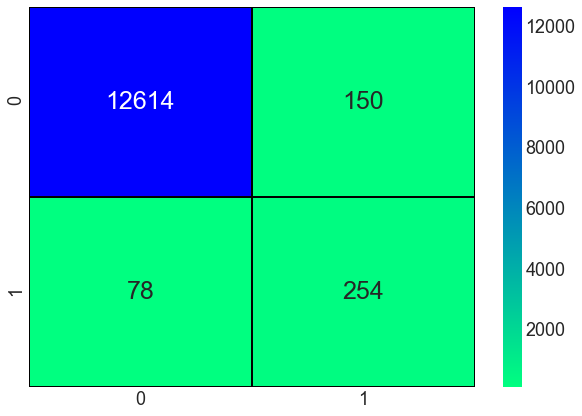

In [169]:
plt.figure(figsize=(10,7))
sns.heatmap(cm, annot=True, annot_kws={'size' : 25}, linewidths=0.7, linecolor='black', cmap = 'winter_r', fmt = "d")

### Now lets get the best_estimator and its parameters we obtained from the *RandomisezsearchCV*

In [90]:
rsCV.best_estimator_

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.3500000000000001,
              gamma=0.5, gpu_id=-1, importance_type='gain',
              interaction_constraints='', learning_rate=0.085, max_delta_step=0,
              max_depth=5, min_child_weight=8, missing=nan,
              monotone_constraints='()', n_estimators=750, n_jobs=8,
              num_parallel_tree=1, random_state=0, reg_alpha=0, reg_lambda=1,
              scale_pos_weight=20, subsample=0.9500000000000002,
              tree_method='exact', validate_parameters=1, verbosity=None)

## Save/Dump the model for production 

In [91]:
import pickle
pickl = {'model': rsCV.best_estimator_ }
pickle.dump( pickl, open( 'Final_model' + ".p", "wb" ) )

## loading the model back (checking....)

In [92]:
file_name = "Final_model.p"
with open(file_name, 'rb') as pickled:
    data = pickle.load(pickled)
    model = data['model']

In [155]:
df_validate = df_test_binary.drop(['remaining_cycle', 'label'], axis = 1)
df_validate.head()

,op1,op2,sensor2,sensor3,sensor4,sensor7,sensor8,sensor9,sensor11,sensor12,sensor13,sensor14,sensor15,sensor17,sensor20,sensor21
0,0.0023,0.0003,643.02,1585.29,1398.21,553.90,2388.04,9050.17,47.20,521.72,2388.03,8125.55,8.4052,392,38.86,23.3735
1,-0.0027,-0.0003,641.71,1588.45,1395.42,554.85,2388.01,9054.42,47.50,522.16,2388.06,8139.62,8.3803,393,39.02,23.3916
2,0.0003,0.0001,642.46,1586.94,1401.34,554.11,2388.05,9056.96,47.50,521.97,2388.03,8130.10,8.4441,393,39.08,23.4166
3,0.0042,0.0000,642.44,1584.12,1406.42,554.07,2388.03,9045.29,47.28,521.38,2388.05,8132.90,8.3917,391,39.00,23.3737
4,0.0014,0.0000,642.51,1587.19,1401.92,554.16,2388.01,9044.55,47.31,522.15,2388.03,8129.54,8.4031,390,38.99,23.4130


In [158]:
df_validate[:1]

,op1,op2,sensor2,sensor3,sensor4,sensor7,sensor8,sensor9,sensor11,sensor12,sensor13,sensor14,sensor15,sensor17,sensor20,sensor21
0,0.0023,0.0003,643.02,1585.29,1398.21,553.9,2388.04,9050.17,47.2,521.72,2388.03,8125.55,8.4052,392,38.86,23.3735


In [159]:
model.predict(df_validate[:1])

array([0], dtype=int64)

In [173]:
y_test[:10] == model.predict(X_test[:10])

13857    True
1710     True
9278     True
10786    True
19709    True
15683    True
5377     True
7738     True
5391     True
18302    True
Name: label, dtype: bool

# This is the End of the Notebook

### onto to Productionizing the model using Flask API........